# Getting Shape Files by Name

In [5]:
import osmnx as ox
import geopandas as gpd

In [4]:
# Specify the name that is used to seach for the data
place_name = "Edgewood Washington, DC, USA"

In [6]:
area = ox.geocode_to_gdf(place_name)

<Axes: >

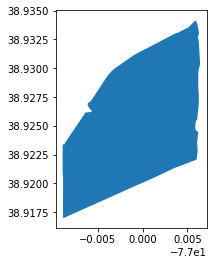

In [8]:
area.plot()

# OSM Building Footprints

In [12]:
# List key-value pairs for tags
tags = {"building": True}

buildings = ox.features_from_place(place_name, tags)
buildings.head()

addr:state amenity building  ele gnis:county_id  \
element_type osmid                                                       
node         358955022         DC  school      yes   60            001   
             367143640         DC     NaN      yes   56            NaN   
way          52291432         NaN     NaN      yes  NaN            NaN   
             55321503         NaN     NaN      yes  NaN            NaN   
             55321504          DC     NaN    house  NaN            NaN   

                            gnis:county_name gnis:created gnis:edited  \
element_type osmid                                                      
node         358955022  District of Columbia   12/18/1979  01/22/2008   
             367143640  District of Columbia          NaN         NaN   
way          52291432                    NaN          NaN         NaN   
             55321503                    NaN          NaN         NaN   
             55321504                    NaN          NaN         NaN   

                       gnis:feature_id                      gnis:import_uuid  \
element_type osmid                                                             
node         358955022         2062869  57871b70-0100-4405-bb30-88b2e001a944   
             367143640         2110453  57871b70-0100-4405-bb30-88b2e001a944   
way          52291432              NaN                                   NaN   
             55321503              NaN                                   NaN   
             55321504              NaN                                   NaN   

                        ... construction:building drive_in open_air operator  \
element_type osmid      ...                                                    
node         358955022  ...                   NaN      NaN      NaN      NaN   
             367143640  ...                   NaN      NaN      NaN      NaN   
way          52291432   ...                   NaN      NaN      NaN      NaN   
             55321503   ...                   NaN      NaN      NaN      NaN   
             55321504   ...                   NaN      NaN      NaN      NaN   

                       screen roof:shape shelter_type start_date ways type  
element_type osmid                                                          
node         358955022    NaN        NaN          NaN        NaN  NaN  NaN  
             367143640    NaN        NaN          NaN        NaN  NaN  NaN  
way          52291432     NaN        NaN          NaN        NaN  NaN  NaN  
             55321503     NaN        NaN          NaN        NaN  NaN  NaN  
             55321504     NaN        NaN          NaN        NaN  NaN  NaN  

[5 rows x 64 columns]

C:\Users\dane.parks\AppData\Roaming\Python\Python310\site-packages\ipykernel\ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<Axes: >

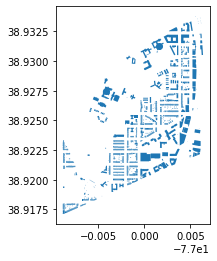

In [13]:
# Plot footprints
buildings.plot()

# Plot a Road Network

In [24]:
import osmnx as ox

columbus = ox.graph_from_place("Columbus, Ohio")

In [17]:
columbus.figure(figsize=(20, 20))

C:\Users\dane.parks\AppData\Roaming\Python\Python310\site-packages\ipykernel\ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


AttributeError: 'tuple' object has no attribute 'figsize'

In [29]:
ox.plot_graph(columbus, figsize=(200, 200))

C:\Users\dane.parks\AppData\Roaming\Python\Python310\site-packages\ipykernel\ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


(<Figure size 14400x14400 with 1 Axes>, <Axes: >)

# Plot a Rail Network

[OpenRailMap.org](https://www.openrailwaymap.org/)

[OpenRailMap API (expirimental)](https://github.com/OpenRailwayMap/OpenRailwayMap-api)

[OpenRailMap Application](https://github.com/OpenRailwayMap/OpenRailwayMap)

[North America Tagging Rules](https://wiki.openstreetmap.org/wiki/OpenRailwayMap/Tagging_in_North_America)

## Basic API Request

In [40]:
import requests

# openrailwaymap blocks python but allows traffic from browsers, so set a header
headers = {
    "User-Agent": "Mozilla/5.0 (Windows NT 6.1; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/56.0.2924.76 Safari/537.36"
}
response = requests.get(
    "https://api.openrailwaymap.org/v2/facility?name=Karlsruhe&limit=1", headers=headers
)

# Printing the response text
data = response.json()[0]

In [41]:
data

{'osm_id': 2574283615,
 'name': 'Karlsruhe Hauptbahnhof',
 'railway': 'station',
 'ref': None,
 'iata': 'KJR',
 'uic_ref': '8000191',
 'website': 'https://www.bahnhof.de/bahnhof-de/bahnhof/Karlsruhe-Hbf-1019530',
 'operator': 'DB Station&Service AG',
 'wikidata': 'Q688541',
 'iata:note': 'AIRail Flughafen',
 'max_level': '1',
 'min_level': '-1',
 'platforms': '7',
 'ref:IFOPT': 'de:08212:90',
 'wikipedia': 'de:Karlsruhe Hauptbahnhof',
 'short_name': 'Karlsruhe Hbf',
 'wheelchair': 'yes',
 'railway:ref': 'RK',
 'ref:station': '3107',
 'internet_access': 'wlan',
 'public_transport': 'station',
 'internet_access:fee': 'no',
 'internet_access:ssid': 'Telekom',
 'internet_access:operator': 'Deutsche Telekom AG',
 'railway:station_category': '1',
 'internet_access:fee:description': '30min kostenlos',
 'latitude': 8.4020518,
 'longitude': 48.9936163996939,
 'rank': 176}